In [1]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

pd.set_option('display.max_columns', None)

In [8]:
# read pickle file from data_cleaned 
biometrics = pd.read_pickle('../data_cleaned/filtered_biometrics.pkl')
biometrics.drop(columns=['MeasureProvidedBy'], inplace=True)
biometrics.shape

(4555157, 11)

### Pivot table to put features as columns

In [9]:
# Create dummy variables for the gender column
biometrics = pd.get_dummies(biometrics, columns=['Gender'], prefix='', prefix_sep='')

# Rename the dummy columns to gender_m and gender_f
biometrics.rename(columns={'M': 'gender_m', 'F': 'gender_f'}, inplace=True)

biometrics['gender_m'] = biometrics['gender_m'].astype(int)
biometrics['gender_f'] = biometrics['gender_f'].astype(int)

# Pivot the dataframe to make each value of 'BiometricName' a new column
biometrics_pivot = biometrics.pivot_table(index=['CloudId', 'gender_m', 'gender_f', 'Age', 'MeasuredOnWeek'], 
                                          columns='BiometricName', 
                                          values='Value', 
                                          aggfunc='last').reset_index()

# Merge the pivoted dataframe with the original dataframe to keep other columns
biometrics_merged = pd.merge(biometrics.drop(columns=['BiometricName', 'Value']), 
                             biometrics_pivot, 
                             on=['CloudId', 'gender_m', 'gender_f', 'Age', 'MeasuredOnWeek'], 
                             how='left').drop_duplicates()

# Group by 'MeasuredOnDate' and aggregate to put measurements on the same row
biometrics_final = biometrics_merged.groupby(['CloudId', 'gender_m', 'gender_f', 'Age', 'MeasuredOnDate']).first().reset_index()

biometrics_final.head()

,CloudId,gender_m,gender_f,Age,MeasuredOnDate,MeasuredOnUTC,MeasuredOn,MeasuredOnDay,MeasuredOnWeek,MeasuredOnYear,BFM Control,BMI,Basal Metabolic Rate,Basal Metabolic Rate Score,Body cell mass,Bone Mass,Bone Mineral Content,Chest Circumference,Degree Of Obesity Perc,Diastolic Blood Pressure,Dry Lean Mass,ECW/TBW,ECW/TBW-LA,ECW/TBW-LLL,ECW/TBW-RA,ECW/TBW-RL,ECW/TBW-TR,Extra Cellular Water,Extra Cellular Water Perc,FFM Control,Fat Free Mass,Fat Free Mass Perc of Ideal Left Arm,Fat Free Mass Perc of Ideal Left Leg,Fat Free Mass Perc of Ideal Right Arm,Fat Free Mass Perc of Ideal Right Leg,Fat Free Mass Perc of Ideal Trunk,Fat Mass,Fat Mass Perc of Ideal Left Arm,Fat Mass Perc of Ideal Left Leg,Fat Mass Perc of Ideal Right Arm,Fat Mass Perc of Ideal Right Leg,Fat Mass Perc of Ideal Trunk,Fat mass Perc,Growth Score,HR At Rest,Height,Hip Circumference,InBody Score,Intra Cellular Water,Left Arm Circumference,Left Arm Fat Free Mass,Left Arm Fat Mass,Left Arm Fat Perc,Left Arm Fat Perc Score,Left Arm Muscle Circumference,Left Arm Muscle Mass,Left Arm Muscle Mass Score,Left Leg Fat Free Mass,Left Leg Fat Mass,Left Leg Fat Perc,Left Leg Fat Perc Score,Left Leg Muscle Mass,Left Leg Muscle Mass Score,Left Thigh Circumference,Leg Muscle Score,Metabolic Age,Minerals,Muscle Mass,Muscle Mass Balance Arm,Muscle Mass Balance Leg,Muscle Score,Neck Circumference,Obesity Degree,Obesity Degree of a Child,Power Threshold,Protein,Right Arm Circumference,Right Arm Fat Free Mass,Right Arm Fat Mass,Right Arm Fat Perc,Right Arm Fat Perc Score,Right Arm Muscle Mass,Right Arm Muscle Mass Score,Right Leg Fat Free Mass,Right Leg Fat Mass,Right Leg Fat Perc,Right Leg Fat Perc Score,Right Leg Muscle Mass,Right Leg Muscle Mass Score,Right Thigh Circumference,Segmental ECW LA,Segmental ECW LL,Segmental ECW RA,Segmental ECW RL,Segmental ECW TR,Segmental ICW LA,Segmental ICW LL,Segmental ICW RA,Segmental ICW RL,Segmental ICW TR,Segmental body water LA,Segmental body water LL,Segmental body water RA,Segmental body water RL,Segmental body water TR,Skeletal Muscle Mass,Soft Lean Mass,Standard Body Weight,Standard Fat Perc,Standard Muscle Mass Perc,Systolic Blood Pressure,TBW/FFM,Target Weight,Total Body Water,Total Body Water Perc,Trunk Fat Free Mass,Trunk Fat Mass,Trunk Fat Perc,Trunk Fat Perc Score,Trunk Muscle Mass,Trunk Muscle Mass Score,VFA (Visceral Fat Area),Visceral Fat Rating,Waist Circumference,Waist-Hip ratio,Weight,Weight Control
0,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,1,0,56,2022-03-07,2022-03-07 19:57:09.961000+00:00,2022-03-07 19:57:09+00:00,66,10,2022,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,88.0,NaN
1,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,1,0,56,2022-05-08,2022-05-08 10:33:57.662000+00:00,2022-05-08 10:33:57+00:00,128,18,2022,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,88.0,NaN
2,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,1,0,56,2022-06-11,2022-06-11 16:18:22.175000+00:00,2022-06-11 16:18:22+00:00,162,23,2022,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Na

In [10]:
# Group by 'CloudId', 'BiometricName', and 'MeasuredOnWeek' and aggregate the values into lists
grouped_measurements = biometrics_final.groupby(['CloudId', 'MeasuredOnWeek']).agg(list).reset_index()
grouped_measurements.head()

,CloudId,MeasuredOnWeek,gender_m,gender_f,Age,MeasuredOnDate,MeasuredOnUTC,MeasuredOn,MeasuredOnDay,MeasuredOnYear,BFM Control,BMI,Basal Metabolic Rate,Basal Metabolic Rate Score,Body cell mass,Bone Mass,Bone Mineral Content,Chest Circumference,Degree Of Obesity Perc,Diastolic Blood Pressure,Dry Lean Mass,ECW/TBW,ECW/TBW-LA,ECW/TBW-LLL,ECW/TBW-RA,ECW/TBW-RL,ECW/TBW-TR,Extra Cellular Water,Extra Cellular Water Perc,FFM Control,Fat Free Mass,Fat Free Mass Perc of Ideal Left Arm,Fat Free Mass Perc of Ideal Left Leg,Fat Free Mass Perc of Ideal Right Arm,Fat Free Mass Perc of Ideal Right Leg,Fat Free Mass Perc of Ideal Trunk,Fat Mass,Fat Mass Perc of Ideal Left Arm,Fat Mass Perc of Ideal Left Leg,Fat Mass Perc of Ideal Right Arm,Fat Mass Perc of Ideal Right Leg,Fat Mass Perc of Ideal Trunk,Fat mass Perc,Growth Score,HR At Rest,Height,Hip Circumference,InBody Score,Intra Cellular Water,Left Arm Circumference,Left Arm Fat Free Mass,Left Arm Fat Mass,Left Arm Fat Perc,Left Arm Fat Perc Score,Left Arm Muscle Circumference,Left Arm Muscle Mass,Left Arm Muscle Mass Score,Left Leg Fat Free Mass,Left Leg Fat Mass,Left Leg Fat Perc,Left Leg Fat Perc Score,Left Leg Muscle Mass,Left Leg Muscle Mass Score,Left Thigh Circumference,Leg Muscle Score,Metabolic Age,Minerals,Muscle Mass,Muscle Mass Balance Arm,Muscle Mass Balance Leg,Muscle Score,Neck Circumference,Obesity Degree,Obesity Degree of a Child,Power Threshold,Protein,Right Arm Circumference,Right Arm Fat Free Mass,Right Arm Fat Mass,Right Arm Fat Perc,Right Arm Fat Perc Score,Right Arm Muscle Mass,Right Arm Muscle Mass Score,Right Leg Fat Free Mass,Right Leg Fat Mass,Right Leg Fat Perc,Right Leg Fat Perc Score,Right Leg Muscle Mass,Right Leg Muscle Mass Score,Right Thigh Circumference,Segmental ECW LA,Segmental ECW LL,Segmental ECW RA,Segmental ECW RL,Segmental ECW TR,Segmental ICW LA,Segmental ICW LL,Segmental ICW RA,Segmental ICW RL,Segmental ICW TR,Segmental body water LA,Segmental body water LL,Segmental body water RA,Segmental body water RL,Segmental body water TR,Skeletal Muscle Mass,Soft Lean Mass,Standard Body Weight,Standard Fat Perc,Standard Muscle Mass Perc,Systolic Blood Pressure,TBW/FFM,Target Weight,Total Body Water,Total Body Water Perc,Trunk Fat Free Mass,Trunk Fat Mass,Trunk Fat Perc,Trunk Fat Perc Score,Trunk Muscle Mass,Trunk Muscle Mass Score,VFA (Visceral Fat Area),Visceral Fat Rating,Waist Circumference,Waist-Hip ratio,Weight,Weight Control
0,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,10,[1],[0],[56],[2022-03-07],[2022-03-07 19:57:09.961000+00:00],[2022-03-07 19:57:09+00:00],[66],[2022],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[88.0],[nan]
1,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,18,[1],[0],[56],[2022-05-08],[2022-05-08 10:33:57.662000+00:00],[2022-05-08 10:33:57+00:00],[128],[2022],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan],[nan]

### Select mean for each week

In [11]:
# Select only the arithmetic columns
arithmetic_columns = biometrics_final.select_dtypes(include=['float64', 'int64']).columns
# Group by 'CloudId' and 'MeasuredOnWeek' and calculate the mean for the arithmetic columns
mean_values = biometrics_final.groupby(['CloudId', 'MeasuredOnWeek'])[arithmetic_columns].mean().reset_index()
mean_values.head()


,CloudId,MeasuredOnWeek,gender_m,gender_f,Age,BFM Control,BMI,Basal Metabolic Rate,Basal Metabolic Rate Score,Body cell mass,Bone Mass,Bone Mineral Content,Chest Circumference,Degree Of Obesity Perc,Diastolic Blood Pressure,Dry Lean Mass,ECW/TBW,ECW/TBW-LA,ECW/TBW-LLL,ECW/TBW-RA,ECW/TBW-RL,ECW/TBW-TR,Extra Cellular Water,Extra Cellular Water Perc,FFM Control,Fat Free Mass,Fat Free Mass Perc of Ideal Left Arm,Fat Free Mass Perc of Ideal Left Leg,Fat Free Mass Perc of Ideal Right Arm,Fat Free Mass Perc of Ideal Right Leg,Fat Free Mass Perc of Ideal Trunk,Fat Mass,Fat Mass Perc of Ideal Left Arm,Fat Mass Perc of Ideal Left Leg,Fat Mass Perc of Ideal Right Arm,Fat Mass Perc of Ideal Right Leg,Fat Mass Perc of Ideal Trunk,Fat mass Perc,Growth Score,HR At Rest,Height,Hip Circumference,InBody Score,Intra Cellular Water,Left Arm Circumference,Left Arm Fat Free Mass,Left Arm Fat Mass,Left Arm Fat Perc,Left Arm Fat Perc Score,Left Arm Muscle Circumference,Left Arm Muscle Mass,Left Arm Muscle Mass Score,Left Leg Fat Free Mass,Left Leg Fat Mass,Left Leg Fat Perc,Left Leg Fat Perc Score,Left Leg Muscle Mass,Left Leg Muscle Mass Score,Left Thigh Circumference,Leg Muscle Score,Metabolic Age,Minerals,Muscle Mass,Muscle Mass Balance Arm,Muscle Mass Balance Leg,Muscle Score,Neck Circumference,Obesity Degree,Obesity Degree of a Child,Power Threshold,Protein,Right Arm Circumference,Right Arm Fat Free Mass,Right Arm Fat Mass,Right Arm Fat Perc,Right Arm Fat Perc Score,Right Arm Muscle Mass,Right Arm Muscle Mass Score,Right Leg Fat Free Mass,Right Leg Fat Mass,Right Leg Fat Perc,Right Leg Fat Perc Score,Right Leg Muscle Mass,Right Leg Muscle Mass Score,Right Thigh Circumference,Segmental ECW LA,Segmental ECW LL,Segmental ECW RA,Segmental ECW RL,Segmental ECW TR,Segmental ICW LA,Segmental ICW LL,Segmental ICW RA,Segmental ICW RL,Segmental ICW TR,Segmental body water LA,Segmental body water LL,Segmental body water RA,Segmental body water RL,Segmental body water TR,Skeletal Muscle Mass,Soft Lean Mass,Standard Body Weight,Standard Fat Perc,Standard Muscle Mass Perc,Systolic Blood Pressure,TBW/FFM,Target Weight,Total Body Water,Total Body Water Perc,Trunk Fat Free Mass,Trunk Fat Mass,Trunk Fat Perc,Trunk Fat Perc Score,Trunk Muscle Mass,Trunk Muscle Mass Score,VFA (Visceral Fat Area),Visceral Fat Rating,Waist Circumference,Waist-Hip ratio,Weight,Weight Control
0,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,10,1.0,0.0,56.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,88.0,NaN
1,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,18,1.0,0.0,56.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,88.0,NaN
2,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,23,1.0,0.0,56.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,88.0,NaN
3,0015d65e3205deb6bb6a8f0d57cc48547918f0

In [12]:
mean_values.shape

(90425, 122)

In [13]:
# store to pickle file
mean_values.to_pickle('../data_cleaned/biometrics_mean_per_week.pkl')

In [3]:
mean_values = pd.read_pickle('../data_cleaned/biometrics_mean_per_week.pkl')

### Apply PCA just for one user

In [4]:
# keep this user id 143137b64375b1b254229751d9efbab80adb87fd
user = mean_values[mean_values['CloudId'] == '143137b64375b1b254229751d9efbab80adb87fd']
# delete columns with nan
user.dropna(axis=1, inplace=True)
# Step 1: Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(user.drop(columns=['MeasuredOnWeek', 'CloudId']))
# Step 2: Apply PCA to reduce dimensionality to 2 components
pca = PCA(n_components=2)
pca_result = pca.fit_transform(scaled_data)
# Step 3: Create a DataFrame for the PCA result
pca_df = pd.DataFrame(pca_result, columns=['PCA1', 'PCA2'])
pca_df['MeasuredOnWeek'] = user['MeasuredOnWeek'].values  # Aligns the indexes
pca_df.sample(2)

/var/folders/3f/hpgbw8dd459305qvgctxmywc0000gn/T/ipykernel_22634/359710521.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  user.dropna(axis=1, inplace=True)


,PCA1,PCA2,MeasuredOnWeek
39,9.406647,-0.206031,50
37,2.743829,4.654516,48


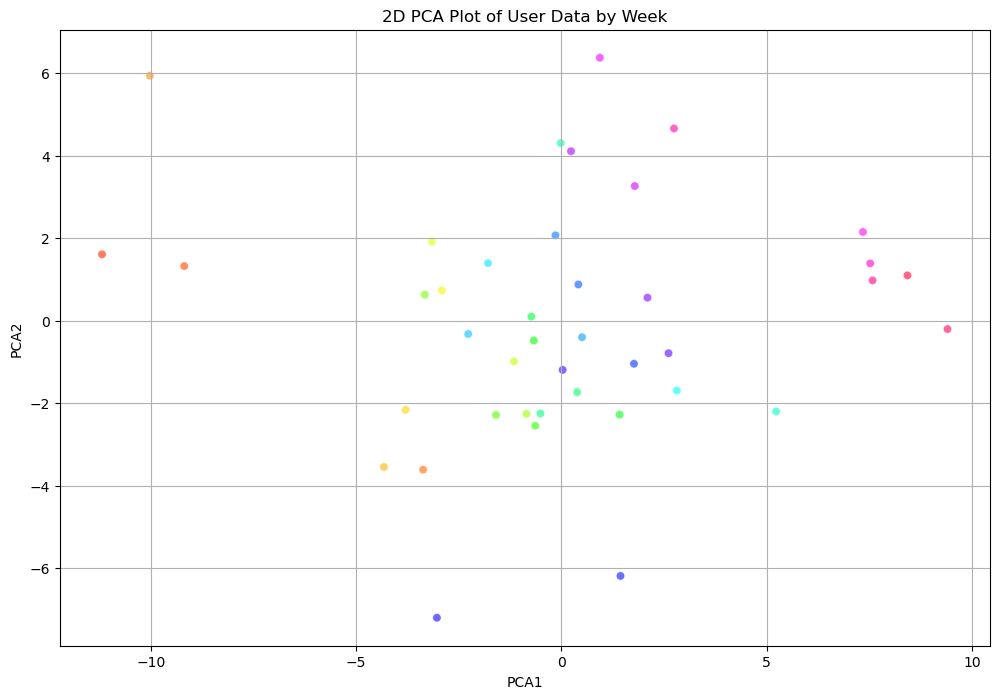

In [5]:
plt.figure(figsize=(12, 8))
sns.scatterplot(
    x='PCA1',
    y='PCA2',
    hue='MeasuredOnWeek',
    palette=sns.color_palette('hsv', len(user['MeasuredOnWeek'].unique())),
    data=pca_df,
    legend=False,
    alpha=0.6
)
plt.title('2D PCA Plot of User Data by Week')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.grid(True)
plt.show()

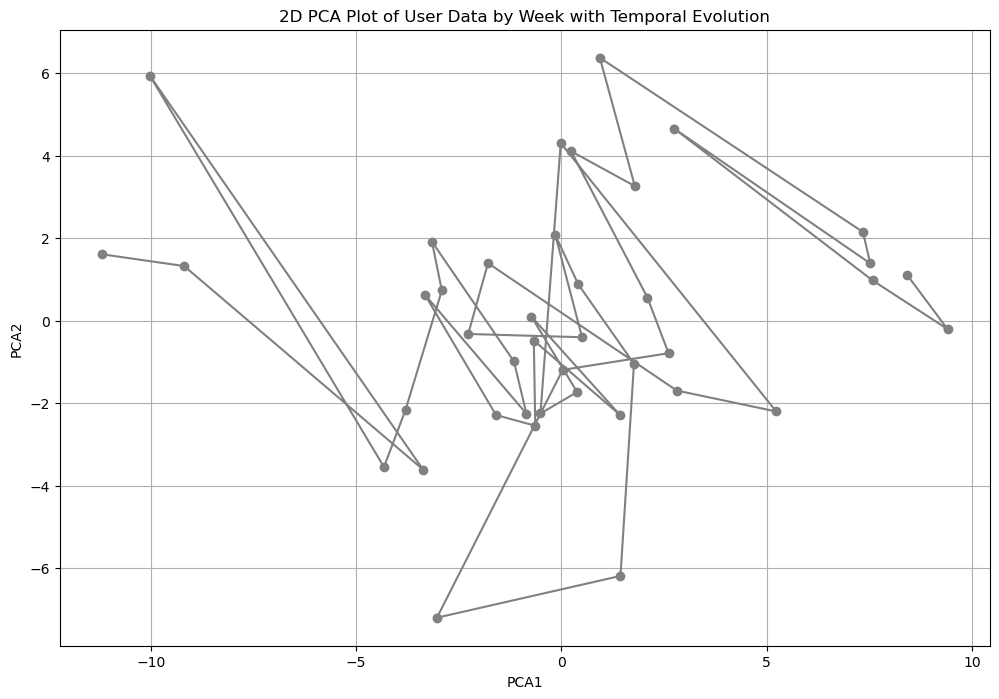

In [6]:
# Step 4: Plot the data
plt.figure(figsize=(12, 8))
sns.scatterplot(
    x='PCA1', y='PCA2',
    hue='MeasuredOnWeek',
    palette=sns.color_palette('hsv', len(user['MeasuredOnWeek'].unique())),
    data=pca_df,
    legend=False,
    alpha=0.6
)

# Add lines connecting the points
plt.plot(pca_df['PCA1'], pca_df['PCA2'], marker='o', linestyle='-', color='gray')

plt.title('2D PCA Plot of User Data by Week with Temporal Evolution')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.grid(True)
plt.show()

#### Interactive for one user

In [7]:
user_pca = pd.merge(user, pca_df, on='MeasuredOnWeek')
user_pca.shape
fig = px.scatter(
    user_pca, 
    x='PCA1', 
    y='PCA2', 
    color='MeasuredOnWeek', 
    title='2D PCA Plot of User Data by Week with Temporal Evolution',
    labels={'PCA1': 'PCA1', 'PCA2': 'PCA2'},
    hover_data=['Basal Metabolic Rate',	'Basal Metabolic Rate Score', 'Degree Of Obesity Perc', 'Weight']
)

# Add lines connecting the points to show temporal evolution
fig.update_traces(mode='lines+markers')

fig.show()

In [8]:
# Step 4: Plot the data with Plotly
import plotly.graph_objects as go
fig = go.Figure()

# Add scatter plot with lines
fig.add_trace(go.Scatter(
    x=user_pca['PCA1'],
    y=user_pca['PCA2'],
    mode='lines+markers',
    line_shape='spline',
    text=user_pca.apply(lambda row: '<br>'.join([f'{col}: {row[col]}' for col in ['Weight', 'Basal Metabolic Rate',	'Basal Metabolic Rate Score', 'Degree Of Obesity Perc']]), axis=1),
    hoverinfo='text',
    marker=dict(size=10, color=user_pca['MeasuredOnWeek'], colorscale='Viridis', showscale=True),
    line=dict(color='gray')
))

fig.update_layout(
    title='2D PCA Plot of User Data by Week with Temporal Evolution',
    xaxis_title='PCA1',
    yaxis_title='PCA2',
    showlegend=False
)

fig.show()

### PCA with all users but only plot one user

In [9]:
all_users = mean_values.copy()

#### Keep only columns where we have more than 50% of values
-> After this only 50 features are kept

In [10]:
# drop columns which contain NaN values for 50% of the rows
all_users.dropna(axis=1, thresh=int(0.5*len(all_users)), inplace=True)
all_users.shape

(90425, 46)

### Use KNN to fill missing values
- Fill the missing values with the mean of the values of the most similar users

In [11]:
from sklearn.impute import KNNImputer
imputer = KNNImputer(n_neighbors=5)
imputed_data = imputer.fit_transform(all_users.drop(columns=['MeasuredOnWeek', 'CloudId']))

KeyboardInterrupt: 

In [133]:
# store the imputed data in a new DataFrame
imputed_df = pd.DataFrame(imputed_data, columns=all_users.drop(columns=['MeasuredOnWeek', 'CloudId']).columns)

In [134]:
imputed_df

,Age,BMI,Basal Metabolic Rate,Basal Metabolic Rate Score,Bone Mass,Degree Of Obesity Perc,Extra Cellular Water,Fat Free Mass,Fat Mass,Fat mass Perc,Height,Intra Cellular Water,Left Arm Fat Free Mass,Left Arm Fat Mass,Left Arm Fat Perc,Left Arm Muscle Mass,Left Leg Fat Free Mass,Left Leg Fat Mass,Left Leg Fat Perc,Left Leg Muscle Mass,Leg Muscle Score,Metabolic Age,Muscle Mass,Right Arm Fat Free Mass,Right Arm Fat Mass,Right Arm Fat Perc,Right Arm Muscle Mass,Right Leg Fat Free Mass,Right Leg Fat Mass,Right Leg Fat Perc,Right Leg Muscle Mass,Standard Body Weight,Standard Fat Perc,Standard Muscle Mass Perc,Total Body Water,Total Body Water Perc,Trunk Fat Free Mass,Trunk Fat Mass,Trunk Fat Perc,Trunk Fat Perc Score,Trunk Muscle Mass,Trunk Muscle Mass Score,Visceral Fat Rating,Weight
0,56.0,29.60,1887.2,10.0,3.80,26.46,18.44,66.44,21.56,23.78,175.8,29.00,3.848,1.20,16.94,4.14,10.098,3.14,20.74,10.46,85.2,43.4,59.54,3.878,1.16,16.20,4.12,10.374,3.18,20.60,10.58,69.92,17.0,55.10,47.00,55.68,32.202,11.74,20.26,-1.4,37.68,2.2,10.2,88.0
1,56.0,29.60,1887.2,10.0,3.80,26.46,18.44,66.44,21.56,23.78,175.8,29.00,3.848,1.20,16.94,4.14,10.098,3.14,20.74,10.46,85.2,43.4,59.54,3.878,1.16,16.20,4.12,10.374,3.18,20.60,10.58,69.92,17.0,55.10,47.00,55.68,32.202,11.74,20.26,-1.4,37.68,2.2,10.2,88.0
2,56.0,29.60,1887.2,10.0,3.80,26.46,18.44,66.44,21.56,23.78,175.8,29.00,3.848,1.20,16.94,4.14,10.098,3.14,20.74,10.46,85.2,43.4,59.54,3.878,1.16,16.20,4.12,10.374,3.18,20.60,10.58,69.92,17.0,55.10,47.00,55.68,32.202,11.74,20.26,-1.4,37.68,2.2,10.2,88.0
3,56.0,28.60,1956.8,8.8,3.74,28.72,18.38,67.36,19.42,22.24,176.6,27.44,4.360,1.12,16.02,4.06,11.100,3.82,21.00,10.50,86.0,44.2,58.70,4.340,1.04,14.88,4.12,11.080,3.90,21.32,10.54,67.92,19.4,52.20,48.18,53.36,37.180,12.58,23.94,-1.4,35.22,1.6,11.0,87.0
4,56.0,28.44,1914.8,8.8,3.38,39.88,18.58,66.92,19.42,20.48,173.4,30.36,4.290,0.68,13.54,4.22,11.100,2.80,20.04,10.66,88.6,41.4,64.44,4.410,0.66,12.84,4.24,11.196,2.84,20.18,10.66,61.92,17.0,47.38,48.74,58.38,34.498,11.16,24.10,-1.0,34.54,1.8,9.6,86.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90420,46.0,26.30,1548.0,8.0,2.90,19.70,15.14,56.10,15.60,21.80,165.0,24.76,2.900,0.60,17.00,2.70,10.200,2.80,21.60,9.60,94.0,39.8,53.20,3.000,0.60,16.10,2.80,10.200,2.90,22.00,9.60,59.90,18.0,46.50,39.00,54.40,29.800,8.70,22.60,0.6,28.50,2.0,12.0,71.7
90421,46.0,26.10,1534.0,8.0,2.90,18.50,14.82,55.60,15.40,21.70,165.0,24.50,2.900,0.60,16.40,2.70,9.800,2.70,21.90,9.30,95.0,35.2,52.70,3.000,0.60,15.50,2.80,9.900,2.80,22.10,9.40,59.90,18.0,46.50,38.20,53.80,30.000,8.70,22.50,0.6,28.50,2.0,12.0,71.0
90422,46.0,26.40,1565.0,9.0,2.90,20.20,15.06,56.70,15.30,21.30,165.0,25.50,3.000,0.60,17.10,2.80,10.500,2.80,21.30,9.90,95.0,40.6,53.80,3.100,0.60,15.80,2.90,10.600,2.90,21.30,10.00,59.90,18.0,46.50,40.30,56.00,29.500,8.40,22.20,1.2,28.20,2.0,12.0,72.0
90423,46.0,26.30,1576.0,9.0,3.00,19.70,15.92,57.10,14.60,20.40,165.0,23.96,2.900,0.50,15.10,2.70,10.000,2.60,20.90,9.40,95.0,33.8,54.10,3.000,0.50,14.70,2.80,10.100,2.70,21.00,9.50,59.90,18.0,46.50,39.60,55.20,31.100,8.30,21.10,1.0,29.70,3.0,12.0,71.7


In [135]:
# store the imputed data to a pickle file
imputed_df.to_pickle('../data_cleaned/biometrics_m50_imputed.pkl')

In [12]:
# read pickle file
imputed_df = pd.read_pickle('../data_cleaned/biometrics_m50_imputed.pkl')

In [13]:
imputed_df.shape

(90425, 44)

In [14]:
imputed_df.sample(2)

,Age,BMI,Basal Metabolic Rate,Basal Metabolic Rate Score,Bone Mass,Degree Of Obesity Perc,Extra Cellular Water,Fat Free Mass,Fat Mass,Fat mass Perc,Height,Intra Cellular Water,Left Arm Fat Free Mass,Left Arm Fat Mass,Left Arm Fat Perc,Left Arm Muscle Mass,Left Leg Fat Free Mass,Left Leg Fat Mass,Left Leg Fat Perc,Left Leg Muscle Mass,Leg Muscle Score,Metabolic Age,Muscle Mass,Right Arm Fat Free Mass,Right Arm Fat Mass,Right Arm Fat Perc,Right Arm Muscle Mass,Right Leg Fat Free Mass,Right Leg Fat Mass,Right Leg Fat Perc,Right Leg Muscle Mass,Standard Body Weight,Standard Fat Perc,Standard Muscle Mass Perc,Total Body Water,Total Body Water Perc,Trunk Fat Free Mass,Trunk Fat Mass,Trunk Fat Perc,Trunk Fat Perc Score,Trunk Muscle Mass,Trunk Muscle Mass Score,Visceral Fat Rating,Weight
21067,68.0,23.2,1431.0,10.0,2.50,5.50,15.70,48.70,22.400,31.50,175.0,18.6,2.6,0.90,26.70,2.50,7.500,4.60,38.0,7.1,84.0,53.0,46.20,2.500,0.90,26.60,2.40,7.500,4.60,38.20,7.10,67.40,30.0,44.80,34.30,48.20,28.600,11.4,28.50,-1.0,27.10,0.0,8.0,71.1
83205,58.0,26.4,1522.2,9.0,2.72,16.28,16.72,51.72,23.658,31.38,169.2,19.0,2.6,1.14,32.52,2.52,8.124,3.26,30.2,8.1,87.2,46.0,51.12,2.636,1.08,30.98,2.56,8.604,3.12,27.76,8.66,64.78,24.2,48.46,35.14,49.76,28.662,11.1,27.52,-1.8,29.28,1.0,8.0,75.3


In [15]:
imputed_df.describe()

,Age,BMI,Basal Metabolic Rate,Basal Metabolic Rate Score,Bone Mass,Degree Of Obesity Perc,Extra Cellular Water,Fat Free Mass,Fat Mass,Fat mass Perc,Height,Intra Cellular Water,Left Arm Fat Free Mass,Left Arm Fat Mass,Left Arm Fat Perc,Left Arm Muscle Mass,Left Leg Fat Free Mass,Left Leg Fat Mass,Left Leg Fat Perc,Left Leg Muscle Mass,Leg Muscle Score,Metabolic Age,Muscle Mass,Right Arm Fat Free Mass,Right Arm Fat Mass,Right Arm Fat Perc,Right Arm Muscle Mass,Right Leg Fat Free Mass,Right Leg Fat Mass,Right Leg Fat Perc,Right Leg Muscle Mass,Standard Body Weight,Standard Fat Perc,Standard Muscle Mass Perc,Total Body Water,Total Body Water Perc,Trunk Fat Free Mass,Trunk Fat Mass,Trunk Fat Perc,Trunk Fat Perc Score,Trunk Muscle Mass,Trunk Muscle Mass Score,Visceral Fat Rating,Weight
count,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.00000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000,90425.000000
mean,49.407885,25.341286,1649.728889,9.696133,3.064165,15.753696,16.81577,57.278848,17.726632,23.351855,171.678343,24.206209,3.205633,0.970590,22.191942,2.973953,9.481269,3.146046,24.746331,9.071794,91.283714,41.889750,51.205138,3.199934,0.935931,21.607645,2.969361,9.569689,3.167504,24.692193,9.164547,64.937158,21.499599,48.816495,40.603000,54.396236,30.823238,9.657715,22.384105,-0.934549,29.974638,0.983646,7.871124,75.660053
std,15.096714,4.104253,337.226123,2.955156,0.736170,18.895178,3.06509,11.726884,8.625060,8.281944,9.388223,5.813922,0.981389,0.690939,9.564925,0.893880,2.081679,1.565070,9.625766,1.928260,9.194265,15.021146,12.707046,0.957174,0.662687,9.418778,0.872584,2.112649,1.589801,9.777944,1.943777,7.252725,5.705128,8.085010,8.481874,6.250350,6.230874,5.225446,8.068288,1.455524,5.610540,1.227943,4.204654,15.952674
min,13.000000,0.000000,855.000000,1.000000,0.000000,-28.700000,9.60000,28.000000,1.300000,2.000000,72.000000,12.500000,1.200000,0.000000,1.000000,1.100000,3.360000,0.000000,1.200000,4.500000,56.000000,12.000000,5.000000,1.100000,0.000000,1.200000,1.100000,3.370000,0.000000,1.000000,4.700000,43.100000,14.000000,29.900000,20.200000,0.000000,11.920000,0.000000,3.000000,-4.000000,14.200000,-4.000000,1.000000,30.000000
25%,38.000000,22.700000,1402.000000,8.000000,2.500000,3.200000,14.40000,48.300000,12.080000,17.600000,165.000000,19.220000,2.400000,0.600000,15.200000,2.240000,7.780000,2.100000,17.200000,7.400000,85.000000,31.000000,41.500000,2.400000,0.580000,14.900000,2.260000,7.800000,2.100000,17.000000,7.420000,59.900000,17.000000,41.880000,33.800000,50.600000,26.500000,6.200000,16.800000,-2.000000,25.800000,0.200000,5.000000,64.800000
50%,50.000000,24.800000,1639.400000,9.200000,3.000000,12.640000,17.10000,57.300000,16.200000,22.500000,172.000000,24.100000,3.140000,0.800000,20.200000,2.860000,9.500000,2.800000,22.600000,9.160000,91.000000,42.000000,51.400000,3.152000,0.800000,19.700000,2.880000,9.600000,2.860000,22.500000,9.200000,65.100000,19.200000,50.000000,40.700000,54.600000,30.406000,8.800000,22.200000,-1.000000,29.900000,1.000000,8.000000,74.000000
75%,61.000000,27.100000,1881.000000,11.000000,3.400000,24.400000,18.98000,65.800000,21.600000,28.560000,178.000000,28.320000,3.900000,1.160000,27.500000,3.680000,10.900000,3.800000,31.800000,10.500000,97.000000,52.000000,60.500000,3.900000,1.100000,26.600000,3.620000,11.080000,3.860000,31.860000,10.600000,69.700000,27.200000,55.000000,46.700000,58.500000,35.500000,12.100000,27.900000,0.000000,34.000000,2.000000,11.000000,84.300000
max,84.000000,100.000000,3041.000000,24.000000,7.300000,150.000000,28.50000,101.60000

In [16]:
# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(imputed_df)

In [17]:
pd.DataFrame(scaled_data, columns=imputed_df.columns).describe()

,Age,BMI,Basal Metabolic Rate,Basal Metabolic Rate Score,Bone Mass,Degree Of Obesity Perc,Extra Cellular Water,Fat Free Mass,Fat Mass,Fat mass Perc,Height,Intra Cellular Water,Left Arm Fat Free Mass,Left Arm Fat Mass,Left Arm Fat Perc,Left Arm Muscle Mass,Left Leg Fat Free Mass,Left Leg Fat Mass,Left Leg Fat Perc,Left Leg Muscle Mass,Leg Muscle Score,Metabolic Age,Muscle Mass,Right Arm Fat Free Mass,Right Arm Fat Mass,Right Arm Fat Perc,Right Arm Muscle Mass,Right Leg Fat Free Mass,Right Leg Fat Mass,Right Leg Fat Perc,Right Leg Muscle Mass,Standard Body Weight,Standard Fat Perc,Standard Muscle Mass Perc,Total Body Water,Total Body Water Perc,Trunk Fat Free Mass,Trunk Fat Mass,Trunk Fat Perc,Trunk Fat Perc Score,Trunk Muscle Mass,Trunk Muscle Mass Score,Visceral Fat Rating,Weight
count,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04,9.042500e+04
mean,-1.253321e-16,1.081549e-15,-9.083632e-16,3.780394e-16,2.608794e-16,2.153041e-17,8.122621e-16,-9.410517e-16,5.346456e-16,-1.137811e-16,2.358915e-15,5.311882e-17,6.847298e-16,-1.602994e-17,-2.461067e-16,1.364116e-16,-1.430122e-16,-6.160525e-17,-1.583349e-16,7.590647e-16,1.330485e-15,9.916560e-17,-2.890104e-16,4.777550e-17,-1.983312e-16,4.706830e-17,-3.506156e-16,-2.358915e-16,2.392311e-16,-2.062676e-16,7.595362e-16,2.061261e-15,-1.823013e-17,4.284080e-16,6.474838e-16,8.016934e-16,-7.424062e-16,-3.731675e-16,-1.281020e-16,-1.376689e-16,-1.264165e-15,-1.744434e-16,1.194388e-17,-6.874015e-16
std,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00,1.000006e+00
min,-2.411656e+00,-6.174430e+00,-2.356678e+00,-2.942715e+00,-4.162329e+00,-2.352661e+00,-2.354191e+00,-2.496742e+00,-1.904534e+00,-2.578136e+00,-1.061744e+01,-2.013490e+00,-2.043678e+00,-1.404748e+00,-2.215601e+00,-2.096438e+00,-2.940561e+00,-2.010174e+00,-2.446191e+00,-2.370956e+00,-3.837600e+00,-1.989856e+00,-3.636202e+00,-2.193901e+00,-1.412334e+00,-2.166710e+00,-2.142338e+00,-2.934573e+00,-1.992401e+00,-2.423037e+00,-2.296854e+00,-3.010907e+00,-1.314544e+00,-2.339713e+00,-2.405496e+00,-8.702959e+00,-3.033819e+00,-1.848219e+00,-2.402519e+00,-2.106092e+00,-2.811624e+00,-4.058554e+00,-1.634180e+00,-2.862235e+00
25%,-7.556577e-01,-6.435520e-01,-7.346117e-01,-5.739603e-01,-7.663562e-01,-6.643899e-01,-7.881604e-01,-7.656678e-01,-6.546810e-01,-6.945093e-01,-7.113572e-01,-8.576374e-01,-8.209152e-01,-5.363595e-01,-7.310021e-01,-8.210913e-01,-8.172625e-01,-6.683735e-01,-7.839764e-01,-8.670011e-01,-6.834422e-01,-7.249653e-01,-7.637645e-01,-8.357288e-01,-5.371051e-01,-7.121606e-01,-8.129469e-01,-8.376678e-01,-6.714737e-01,-7.866926e-01,-8.975089e-01,-6.945233e-01,-7.886980e-01,-8.579499e-01,-8.020678e-01,-6.073671e-01,-6.938452e-01,-6.617107e-01,-6.921092e-01,-7.320090e-01,-7.440748e-01,-6.381813e-01,-6.828481e-01,-6.807707e-01
50%,3.922167e-02,-1.318848e-01,-3.062914e-02,-1.678881e-01,-8.716164e-02,-1.647888e-01,9.273202e-02,1.803720e-03,-1.770005e-01,-1.028575e-01,3.426193e-02,-1.826813e-02,-6.687796e-02,-2.468969e-01,-2.082560e-01,-1.274

In [18]:
# Apply PCA to reduce dimensionality to 2 components
pca = PCA(n_components=2)
pca_result = pca.fit_transform(scaled_data)

In [19]:
# Step 3: Create a DataFrame for the PCA result
pca_df = pd.DataFrame(pca_result, columns=['PCA1', 'PCA2'])
pca_df['MeasuredOnWeek'] = all_users['MeasuredOnWeek'].values  # Aligns the indexes
pca_df['CloudId'] = all_users['CloudId'].values  # Aligns the indexes

In [20]:
pca_df

,PCA1,PCA2,MeasuredOnWeek,CloudId
0,3.868325,0.504470,10,0015d65e3205deb6bb6a8f0d57cc48547918f0f2
1,3.868325,0.504470,18,0015d65e3205deb6bb6a8f0d57cc48547918f0f2
2,3.868325,0.504470,23,0015d65e3205deb6bb6a8f0d57cc48547918f0f2
3,4.043737,0.830629,24,0015d65e3205deb6bb6a8f0d57cc48547918f0f2
4,4.010558,-0.164433,25,0015d65e3205deb6bb6a8f0d57cc48547918f0f2
...,...,...,...,...
90420,-0.191577,-0.407281,32,fff39b07939109e856b411ff8dd9b22da1f1ff2e
90421,-0.401015,-0.558186,36,fff39b07939109e856b411ff8dd9b22da1f1ff2e
90422,0.137179,-0.531003,40,fff39b07939109e856b411ff8dd9b22da1f1ff2e
90423,0.058485,-0.779759,44,fff39b07939109e856b411ff8dd9b22da1f1ff2e


#### Keep only one user

In [21]:
user_compall = pca_df[pca_df['CloudId'] == '143137b64375b1b254229751d9efbab80adb87fd']
user_all_fields = all_users[all_users['CloudId'] == '143137b64375b1b254229751d9efbab80adb87fd']

In [22]:
user_compall_all = pd.merge(user_compall, user_all_fields, on='MeasuredOnWeek')

In [23]:
user_compall_all

,PCA1,PCA2,MeasuredOnWeek,CloudId_x,CloudId_y,Age,BMI,Basal Metabolic Rate,Basal Metabolic Rate Score,Bone Mass,Degree Of Obesity Perc,Extra Cellular Water,Fat Free Mass,Fat Mass,Fat mass Perc,Height,Intra Cellular Water,Left Arm Fat Free Mass,Left Arm Fat Mass,Left Arm Fat Perc,Left Arm Muscle Mass,Left Leg Fat Free Mass,Left Leg Fat Mass,Left Leg Fat Perc,Left Leg Muscle Mass,Leg Muscle Score,Metabolic Age,Muscle Mass,Right Arm Fat Free Mass,Right Arm Fat Mass,Right Arm Fat Perc,Right Arm Muscle Mass,Right Leg Fat Free Mass,Right Leg Fat Mass,Right Leg Fat Perc,Right Leg Muscle Mass,Standard Body Weight,Standard Fat Perc,Standard Muscle Mass Perc,Total Body Water,Total Body Water Perc,Trunk Fat Free Mass,Trunk Fat Mass,Trunk Fat Perc,Trunk Fat Perc Score,Trunk Muscle Mass,Trunk Muscle Mass Score,Visceral Fat Rating,Weight
0,5.991354,-1.683152,3,143137b64375b1b254229751d9efbab80adb87fd,143137b64375b1b254229751d9efbab80adb87fd,40.0,26.8,2131.0,9.0,3.5,23.4,19.8,73.3,14.7,18.1,180.0,32.6,4.7,0.8,14.6,4.4,11.8,2.4,17.0,11.2,92.0,25.0,69.7,4.5,0.8,15.0,4.2,12.1,2.4,18.0,11.5,71.3,14.0,58.2,50.7,60.1,40.2,8.3,18.5,-2.0,37.4,2.0,6.0,86.7
1,5.961323,-1.484630,4,143137b64375b1b254229751d9efbab80adb87fd,143137b64375b1b254229751d9efbab80adb87fd,40.0,27.0,2097.0,9.0,3.6,22.7,20.0,72.1,15.4,17.2,180.0,32.4,4.6,0.9,15.6,4.3,11.6,2.5,17.6,11.2,91.0,26.0,68.5,4.5,0.8,15.5,4.2,11.9,2.5,17.3,11.4,71.3,14.0,58.2,52.6,59.6,40.1,8.7,17.7,-2.0,37.8,2.0,7.0,88.2
2,5.495341,-1.142486,5,143137b64375b1b254229751d9efbab80adb87fd,143137b64375b1b254229751d9efbab80adb87fd,40.0,26.9,2082.0,9.0,3.5,23.0,19.8,71.5,16.3,18.5,180.0,31.2,4.5,0.9,15.8,4.2,11.5,2.6,18.1,10.9,90.0,30.0,68.0,4.3,0.9,16.5,4.0,11.7,2.5,18.4,11.1,71.3,14.0,58.2,51.0,58.1,39.5,9.3,19.1,-2.0,37.7,2.0,7.0,87.0
3,6.027777,-1.370751,6,143137b64375b1b254229751d9efbab80adb87fd,143137b64375b1b254229751d9efbab80adb87fd,40.0,27.4,2132.0,9.0,3.6,24.4,20.3,73.3,15.4,17.4,180.0,32.4,4.7,0.8,15.0,4.4,11.7,2.5,17.8,11.1,91.0,27.0,69.7,4.5,0.8,15.8,4.2,12.1,2.5,17.1,11.5,71.3,17.0,56.2,52.7,59.4,40.3,8.8,17.9,-2.0,38.5,2.0,7.0,88.7
4,5.400327,-1.279010,7,143137b64375b1b254229751d9efbab80adb87fd,143137b64375b1b254229751d9efbab80adb87fd,40.0,26.9,2083.0,9.0,3.5,22.3,19.9,71.7,15.5,17.8,180.0,31.3,4.5,0.9,15.9,4.2,11.5,2.5,17.9,10.9,90.0,28.0,68.2,4.3,0.8,16.0,4.0,11.7,2.6,18.1,11.1,71.3,17.0,56.2,51.2,58.7,39.7,8.7,18.0,-2.0,38.0,2.0,7.0,87.2
5,5.458275,-1.171427,8,143137b64375b1b254229751d9efbab80adb87fd,143137b64375b1b254229751d9efbab80adb87fd,40.0,27.0,2085.0,9.0,3.5,23.0,20.0,72.0,16.0,17.9,180.0,31.4,4.5,0.9,16.3,4.2,11.5,2.6,18.2,10.9,90.0,29.0,68.3,4.3,0.8,16.0,4.0,11.8,2.6,18.0,11.2,71.3,17.0,56.2,51.5,58.7,39.7,9.0,18.4,-2.0,37.9,2.0,7.0,88.4
6,5.598308,-0.950731,9,143137b64375b1b254229751d9efbab80adb87fd,143137b64375b1b254229751d9efbab80adb87fd,40.0,27.4,2081.0,9.0,3.5,23.4,20.2,71.5,16.3,18.3,180.0,31.9,4.6,0.9,16.4,4.2,11.7,2.7,18.8,11.1,89.0,31.0,68.5,4.3,0.9,16.5,4.1,12.0,2.7,17.4,11.1,71.3,17.0,56.2,51.6,58.4,40.0,9.3,19.1,-2.0,37.8,2.0,7.0,88.9
7,5.639198,-0.942881,10,143137b64375b1b254229751d9efbab80adb87fd,143137b64375b1b254229751d9efbab80adb87fd,40.0,27.4,2105.0,9.0,3.6,24.5,20.1,72.3,16.5,18.6,180.0,31.5,4.5,0.9,16.6,4.2,11.7,2.6,18.4,11.1,90.0,30.0,68.7,4.4,0.9,16.3,4.1,11.9,2.7,18.5,11.3,71.3,17.0,56.2,51.6,58.1,39.8,9.4,19.1,-2.0,38.0,2.0,7.0,88.8
8,5.476670,-0.827450,11,143137b64375b1b254229751d9efbab80adb87fd,143137b64375b1b254229751d9efbab80adb87fd,40.0,27.5,2067.0,9.0,3.6,23.1,19.7,71.0,16.8,18.5,180.0,30.8,4.6,0.9,16.9,4.3,11.4,2.7,18.7,10.9,88.0,30.0,67.5,4.4,0.9,17.3,4.1,11.7,2.7,19.4,11.1,71.3,17.0,56.2,52.1,57.5,39.8,9.3,18.8,-2.0,38.3,2.0,7.0,89.2
9,5.370513,-0.879389,12,143137b64375b1b254229751d9efbab80adb87fd,143137b64375b1b254229751d9efbab80adb87fd,40.0,27.2,2081.0,9.0,3.5,23.6,19.9,71.5,16.5,18.7,180.0,31.1,4.6,0.9,16.2,4.3,11.4,2.7,19.0,10.8,89.0,31.0,68.1,4.3,0.9,16.6,4.0,11.7,2.8,19.5,11.1,71.3,17.0,56.2,51.0,57.9,39.5,9.3,19.1,-2.0,37.8,2.0,7.0,88.0


In [24]:
# Step 4: Plot the data with Plotly
import plotly.graph_objects as go
fig = go.Figure()

# Add scatter plot with lines
fig.add_trace(go.Scatter(
    x=user_compall_all['PCA1'],
    y=user_compall_all['PCA2'],
    mode='lines+markers',
    line_shape='spline',
    text=user_compall_all.apply(lambda row: '<br>'.join([f'{col}: {row[col]}' for col in ['Weight', 'Basal Metabolic Rate',	'Basal Metabolic Rate Score', 'Degree Of Obesity Perc']]), axis=1),
    hoverinfo='text',
    marker=dict(size=10, color=user_compall_all['MeasuredOnWeek'], colorscale='Viridis', showscale=True),
    line=dict(color='gray')
))

fig.update_layout(
    title='2D PCA Plot of User Data by Week with Temporal Evolution',
    xaxis_title='PCA1',
    yaxis_title='PCA2',
    showlegend=False
)

fig.show()

### Do it for multiple users

In [25]:
#merge on fields MeasuredOnWeek and CloudId
all = pd.merge(pca_df, all_users, on=['MeasuredOnWeek', 'CloudId'])

In [26]:
all

,PCA1,PCA2,MeasuredOnWeek,CloudId,Age,BMI,Basal Metabolic Rate,Basal Metabolic Rate Score,Bone Mass,Degree Of Obesity Perc,Extra Cellular Water,Fat Free Mass,Fat Mass,Fat mass Perc,Height,Intra Cellular Water,Left Arm Fat Free Mass,Left Arm Fat Mass,Left Arm Fat Perc,Left Arm Muscle Mass,Left Leg Fat Free Mass,Left Leg Fat Mass,Left Leg Fat Perc,Left Leg Muscle Mass,Leg Muscle Score,Metabolic Age,Muscle Mass,Right Arm Fat Free Mass,Right Arm Fat Mass,Right Arm Fat Perc,Right Arm Muscle Mass,Right Leg Fat Free Mass,Right Leg Fat Mass,Right Leg Fat Perc,Right Leg Muscle Mass,Standard Body Weight,Standard Fat Perc,Standard Muscle Mass Perc,Total Body Water,Total Body Water Perc,Trunk Fat Free Mass,Trunk Fat Mass,Trunk Fat Perc,Trunk Fat Perc Score,Trunk Muscle Mass,Trunk Muscle Mass Score,Visceral Fat Rating,Weight
0,3.868325,0.504470,10,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,56.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,88.0
1,3.868325,0.504470,18,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,56.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,88.0
2,3.868325,0.504470,23,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,56.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,88.0
3,4.043737,0.830629,24,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,56.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,87.0
4,4.010558,-0.164433,25,0015d65e3205deb6bb6a8f0d57cc48547918f0f2,56.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,86.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90420,-0.191577,-0.407281,32,fff39b07939109e856b411ff8dd9b22da1f1ff2e,46.0,26.3,1548.0,8.0,2.9,19.7,NaN,56.1,15.6,21.8,165.0,NaN,2.9,0.6,17.0,2.7,10.2,2.8,21.6,9.6,94.0,NaN,53.2,3.0,0.6,16.1,2.8,10.2,2.9,22.0,9.6,59.9,18.0,46.5,39.0,54.4,29.8,8.7,22.6,NaN,28.5,2.0,12.0,71.7
90421,-0.401015,-0.558186,36,fff39b07939109e856b411ff8dd9b22da1f1ff2e,46.0,26.1,1534.0,8.0,2.9,18.5,NaN,55.6,15.4,21.7,165.0,NaN,2.9,0.6,16.4,2.7,9.8,2.7,21.9,9.3,95.0,NaN,52.7,3.0,0.6,15.5,2.8,9.9,2.8,22.1,9.4,59.9,18.0,46.5,38.2,53.8,30.0,8.7,22.5,NaN,28.5,2.0,12.0,71.0
90422,0.137179,-0.531003,40,fff39b07939109e856b411ff8dd9b22da1f1ff2e,46.0,26.4,1565.0,9.0,2.9,20.2,NaN,56.7,15.3,21.3,165.0,NaN,3.0,0.6,17.1,2.8,10.5,2.8,21.3,9.9,95.0,NaN,53.8,3.1,0.6,15.8,2.9,10.6,2.9,21.3,10.0,59.9,18.0,46.5,40.3,56.0,29.5,8.4,22.2,NaN,28.2,2.0,12.0,72.0
90423,0.058485,-0.779759,44,fff39b07939109e856b411ff8dd9b22da1f1ff2e,46.0,26.3,1576.0,9.0,3.0,19.7,NaN,57.1,14.6,20.4,165.0,NaN,2.9,0.5,15.1,2.7,10.0,2.6,20.9,9.4,95.0,NaN,54.1,3.0,0.5,14.7,2.8,10.1,2.7,21.0,9.5,59.9,18.0,46.5,39.6,55.2,31.1,8.3,21.1,NaN,29.7,3.0,12.0,71.7


In [27]:
unique_cloud_ids = all['CloudId'].unique()[:30]

# Initialize a new figure
fig = go.Figure()

# Iterate over each selected CloudId and add a trace for each
for cloud_id in unique_cloud_ids:
    user_data = all[all['CloudId'] == cloud_id]
    fig.add_trace(go.Scatter(
        x=user_data['PCA1'],
        y=user_data['PCA2'],
        mode='lines+markers',
        line_shape='spline',
        name=f'{cloud_id[:4]}',
        text=user_data.apply(lambda row: '<br>'.join([f'{col}: {row[col]}' for col in ['Weight', 'Basal Metabolic Rate', 'Basal Metabolic Rate Score', 'Degree Of Obesity Perc']]), axis=1),
        hoverinfo='text',
        marker=dict(size=2, showscale=True),  # Adjusted marker size
        line=dict(shape='spline')
    ))

fig.update_layout(
    title='2D PCA Plot of User Data by Week with Temporal Evolution',
    xaxis_title='PCA1',
    yaxis_title='PCA2',
    showlegend=True
)

fig.show()

In [28]:
# keep only weights larger than 90
all_users_lw = all[all['Weight'] > 90]

In [29]:
unique_cloud_ids = all_users_lw['CloudId'].unique()[:50]
# Initialize a new figure
fig = go.Figure()

# Iterate over each selected CloudId and add a trace for each
for cloud_id in unique_cloud_ids:
    user_data = all_users_lw[all_users_lw['CloudId'] == cloud_id]
    fig.add_trace(go.Scatter(
        x=user_data['PCA1'],
        y=user_data['PCA2'],
        mode='lines+markers',
        line_shape='spline',
        name=f'{cloud_id[:4]}',
        text=user_data.apply(lambda row: '<br>'.join([f'{col}: {row[col]}' for col in ['Weight', 'Basal Metabolic Rate', 'Basal Metabolic Rate Score', 'Degree Of Obesity Perc']]), axis=1),
        hoverinfo='text',
        marker=dict(size=2, showscale=True),  # Adjusted marker size
        line=dict(shape='spline')
    ))

fig.update_layout(
    title='2D PCA Plot of User Data by Week with Temporal Evolution',
    xaxis_title='PCA1',
    yaxis_title='PCA2',
    showlegend=True
)

fig.show()

### Cluster biometrics

In [30]:
bio = imputed_df.copy()

In [31]:
bio['CloudId'] = all_users['CloudId'].values  # Aligns the indexes
bio['MeasuredOnWeek'] = all_users['MeasuredOnWeek'].values  # Aligns the indexes

In [32]:
bio.columns

Index(['Age', 'BMI', 'Basal Metabolic Rate', 'Basal Metabolic Rate Score',
       'Bone Mass', 'Degree Of Obesity Perc', 'Extra Cellular Water',
       'Fat Free Mass', 'Fat Mass', 'Fat mass Perc', 'Height',
       'Intra Cellular Water', 'Left Arm Fat Free Mass', 'Left Arm Fat Mass',
       'Left Arm Fat Perc', 'Left Arm Muscle Mass', 'Left Leg Fat Free Mass',
       'Left Leg Fat Mass', 'Left Leg Fat Perc', 'Left Leg Muscle Mass',
       'Leg Muscle Score', 'Metabolic Age', 'Muscle Mass',
       'Right Arm Fat Free Mass', 'Right Arm Fat Mass', 'Right Arm Fat Perc',
       'Right Arm Muscle Mass', 'Right Leg Fat Free Mass',
       'Right Leg Fat Mass', 'Right Leg Fat Perc', 'Right Leg Muscle Mass',
       'Standard Body Weight', 'Standard Fat Perc',
       'Standard Muscle Mass Perc', 'Total Body Water',
       'Total Body Water Perc', 'Trunk Fat Free Mass', 'Trunk Fat Mass',
       'Trunk Fat Perc', 'Trunk Fat Perc Score', 'Trunk Muscle Mass',
       'Trunk Muscle Mass Score', 'Visce

In [33]:
from sklearn.cluster import KMeans

bio_features = bio.drop(columns=['CloudId', 'MeasuredOnWeek'])

scaler = StandardScaler()
bio_scaled = scaler.fit_transform(bio_features)

num_clusters = 6  # Adjust the number of clusters as needed
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
bio['Cluster'] = kmeans.fit_predict(bio_scaled)

# Add cluster labels to the DataFrame
bio['Cluster'] = kmeans.labels_

# Optional: Visualize the clusters using PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(bio_scaled)
pca_df_bio = pd.DataFrame(pca_result, columns=['PCA1', 'PCA2'])
pca_df_bio['Cluster'] = bio['Cluster']
pca_df_bio['CloudId'] = bio['CloudId']


fig = px.scatter(
    pca_df_bio, 
    x='PCA1', 
    y='PCA2', 
    color='Cluster', 
    title='PCA of Biometric Profiles',
    hover_data=['CloudId'],
)

fig.update_traces(marker=dict(size=1))

fig.show()

In [34]:
# Group by 'Cluster' and calculate the mean for each group, keeping only numerical features
numerical_features = [col for col in bio.columns if bio[col].dtype in ['int64', 'float64']]

cluster_means = bio.groupby('Cluster')[numerical_features].mean()

# Add the count of records in each cluster
cluster_counts = bio['Cluster'].value_counts().sort_index()
cluster_means['Count'] = cluster_counts

# Display the average column values for each cluster along with the count
cluster_means

,Age,BMI,Basal Metabolic Rate,Basal Metabolic Rate Score,Bone Mass,Degree Of Obesity Perc,Extra Cellular Water,Fat Free Mass,Fat Mass,Fat mass Perc,Height,Intra Cellular Water,Left Arm Fat Free Mass,Left Arm Fat Mass,Left Arm Fat Perc,Left Arm Muscle Mass,Left Leg Fat Free Mass,Left Leg Fat Mass,Left Leg Fat Perc,Left Leg Muscle Mass,Leg Muscle Score,Metabolic Age,Muscle Mass,Right Arm Fat Free Mass,Right Arm Fat Mass,Right Arm Fat Perc,Right Arm Muscle Mass,Right Leg Fat Free Mass,Right Leg Fat Mass,Right Leg Fat Perc,Right Leg Muscle Mass,Standard Body Weight,Standard Fat Perc,Standard Muscle Mass Perc,Total Body Water,Total Body Water Perc,Trunk Fat Free Mass,Trunk Fat Mass,Trunk Fat Perc,Trunk Fat Perc Score,Trunk Muscle Mass,Trunk Muscle Mass Score,Visceral Fat Rating,Weight,Count
Cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,47.988330,30.845659,2142.780029,7.117296,3.834596,40.033681,21.186571,73.307559,27.681653,27.501235,180.505036,31.096510,4.532080,1.578681,24.048288,4.187271,12.410166,4.157113,24.294061,11.692243,84.361136,52.279313,63.375730,4.516495,1.502581,23.366755,4.162990,12.484934,4.204054,24.415645,11.746401,71.415909,16.904063,56.476440,51.950122,51.718912,38.507229,17.162497,29.137428,0.818232,37.361577,1.909149,12.877441,101.250182,9083
1,49.068893,22.332972,1296.210771,10.600998,2.370281,2.366712,13.211802,44.181260,15.814518,26.024055,162.963755,17.780016,2.098302,0.781438,25.417830,1.970989,7.066047,3.271463,31.860984,6.777125,95.066233,37.312292,39.643104,2.129604,0.759496,24.635797,1.993449,7.122930,3.307682,31.900906,6.842684,57.892967,28.007859,39.636258,31.156528,52.274824,24.394287,7.389589,22.274967,-1.353067,23.742344,0.482397,4.615907,59.701514,21047
2,46.628216,31.144575,1592.865055,6.361197,2.876356,41.243381,16.871218,52.998914,33.488833,37.871823,166.648192,21.196615,2.749443,2.294837,42.335371,2.504774,8.442498,6.288743,43.247847,7.868553,78.254093,54.229053,47.693202,2.700724,2.193623,41.643806,2.447739,8.511494,6.351230,43.246283,7.935548,60.898609,27.985966,41.505306,37.726030,44.523632,29.765469,16.505646,34.142223,0.084181,28.676294,2.003939,9.870048,86.158221,8123
3,45.370910,22.359755,1596.152623,12.073775,3.092046,1.670573,15.898051,56.822181,9.628439,14.256651,172.353089,24.330454,3.161587,0.460665,13.122682,2.944345,9.619670,1.753787,15.598234,9.293612,100.293080,31.184766,49.446017,3.174665,0.447329,12.598826,2.958077,9.721265,1.758813,15.379433,9.430000,65.340714,17.922013,50.842436,40.672668,60.955928,29.374996,4.971481,14.299865,-1.941491,28.948682,0.276296,5.683670,66.680755,12774
4,40.583710,25.401716,1979.714193,9.777821,3.621266,14.951446,19.067381,69.288858,14.176600,16.953973,181.106814,30.023908,4.207756,0.721674,15.327309,3.943942,11.260276,2.186161,16.387402,10.824447,93.984747,31.146245,59.536390,4.175767,0.699771,15.026660,3.908544,11.431188,2.181519,16.036216,11.012121,72.035599,16.035227,57.529807,49.275933,58.377213,36.102901,8.020398,18.002963,-1.697662,35.345393,1.287250,6.235569,83.128296,18134
5,61.362067,25.490358,1561.525682,9.678038,3.001775,18.039900,17.125896,55.063178,17.237967,24.307698,170.009227,23.737302,3.081181,0.910796,21.813482,2.818215,9.417286,3.044463,23.453852,9.055437,87.758531,52.861785,52.743897,3.070654,0.882988,21.229213,2.830554,9.471908,3.056883,23.563710,9.094270,64.388794,21.352126,48.776210,38.766973,54.075418,30.675908,10.292525,23.708460,-0.402483,29.520080,0.860704,10.899934,75.539665,21264


In [45]:
# standardize the cluster means
scaler = StandardScaler()
cluster_means_scaled = scaler.fit_transform(cluster_means)
# store to df
cluster_means_scaled_df = pd.DataFrame(cluster_means_scaled, columns=cluster_means.columns)

In [47]:
cluster_means_scaled_df

,Age,BMI,Basal Metabolic Rate,Basal Metabolic Rate Score,Bone Mass,Degree Of Obesity Perc,Extra Cellular Water,Fat Free Mass,Fat Mass,Fat mass Perc,Height,Intra Cellular Water,Left Arm Fat Free Mass,Left Arm Fat Mass,Left Arm Fat Perc,Left Arm Muscle Mass,Left Leg Fat Free Mass,Left Leg Fat Mass,Left Leg Fat Perc,Left Leg Muscle Mass,Leg Muscle Score,Metabolic Age,Muscle Mass,Right Arm Fat Free Mass,Right Arm Fat Mass,Right Arm Fat Perc,Right Arm Muscle Mass,Right Leg Fat Free Mass,Right Leg Fat Mass,Right Leg Fat Perc,Right Leg Muscle Mass,Standard Body Weight,Standard Fat Perc,Standard Muscle Mass Perc,Total Body Water,Total Body Water Perc,Trunk Fat Free Mass,Trunk Fat Mass,Trunk Fat Perc,Trunk Fat Perc Score,Trunk Muscle Mass,Trunk Muscle Mass Score,Visceral Fat Rating,Weight,Count
0,-0.080626,1.280615,1.585866,-1.094956,1.454506,1.272915,1.592632,1.487804,0.972662,0.393654,1.230195,1.372906,1.474294,0.726627,0.039235,1.449602,1.546735,0.476014,-0.159247,1.471283,-0.762996,0.894969,1.450154,1.488298,0.711796,0.030273,1.454569,1.521705,0.482668,-0.139796,1.433268,1.186823,-0.898394,1.083798,1.467385,-0.369275,1.517794,1.401801,0.839820,1.572543,1.494448,1.169951,1.493089,1.662918,-1.115590
1,0.089525,-1.097982,-1.411521,0.678495,-1.580011,-1.087131,-1.614861,-1.460658,-0.468318,0.200807,-1.388422,-1.482643,-1.449943,-0.549363,0.184150,-1.404426,-1.506232,-0.120431,0.637191,-1.492046,0.697696,-0.575330,-1.594786,-1.419116,-0.542721,0.165906,-1.381384,-1.506668,-0.112157,0.640300,-1.491677,-1.449774,1.336373,-1.399819,-1.478165,-0.263208,-1.526151,-0.725871,-0.199891,-0.606510,-1.515265,-0.990791,-1.239760,-1.406873,1.113416
2,-0.294797,1.364138,-0.361178,-1.479864,-0.531266,1.348709,-0.143025,-0.568044,1.677806,1.747542,-0.838398,-0.749998,-0.667584,1.872838,1.974246,-0.717041,-0.719899,1.911570,1.835689,-0.834022,-1.596292,1.086504,-0.561943,-0.723448,1.878453,1.983699,-0.787551,-0.722430,1.907516,1.822687,-0.839811,-0.863757,1.331967,-1.124169,-0.547552,-1.742132,-0.367669,1.258797,1.598081,0.835870,-0.424912,1.313506,0.498268,0.547860,-1.294447
3,-0.492779,-1.090499,-0.349538,1.428243,-0.084289,-1.130748,-0.534438,-0.181014,-1.219470,-1.335437,0.013247,-0.077986,-0.172384,-1.062761,-1.116836,-0.150982,-0.047409,-1.142516,-1.074507,0.025147,1.410890,-1.177274,-0.337054,-0.146153,-1.069739,-1.120589,-0.120453,-0.039170,-1.139973,-1.081528,0.051593,0.002330,-0.693519,0.252886,-0.130141,1.393144,-0.451889,-1.252321,-1.408174,-1.197036,-0.364717,-1.302920,-0.886553,-0.891217,-0.427922
4,-1.246598,-0.240520,1.008511,0.259439,1.012419,-0.298627,0.740283,1.080990,-0.667205,-0.983300,1.320031,1.142901,1.084611,-0.645015,-0.883558,1.136254,0.889830,-0.851332,-0.991445,0.948088,0.550129,-1.181058,0.957559,1.073265,-0.643553,-0.861105,1.121966,0.926566,-0.859469,-1.013080,0.995288,1.307646,-1.073257,1.239150,1.088569,0.901126,0.999217,-0.588537,-0.847129,-0.952336,1.048891,0.228118,-0.703989,0.323996,0.570697
5,2.025276,-0.215752,-0.472139,0.208643,-0.271359,-0.105118,-0.040592,-0.359078,-0.295474,-0.023265,-0.336652,-0.205180,-0.268993,-0.342326,-0.197237,-0.313407,-0.163026,-0.273305,-0.247682,-0.118449,-0.299427,0.952189,0.086070,-0.272846,-0.334235,-0.198185,-0.287147,-0.180003,-0.278585,-0.228583,-0.148662,-0.183268,-0.003170,-0.051845,-0.400095,0.080345,-0.171302,-0.093869,0.017293,0.347469,-0.238444,-0.417865,0.838946,-0.236684,1.153845


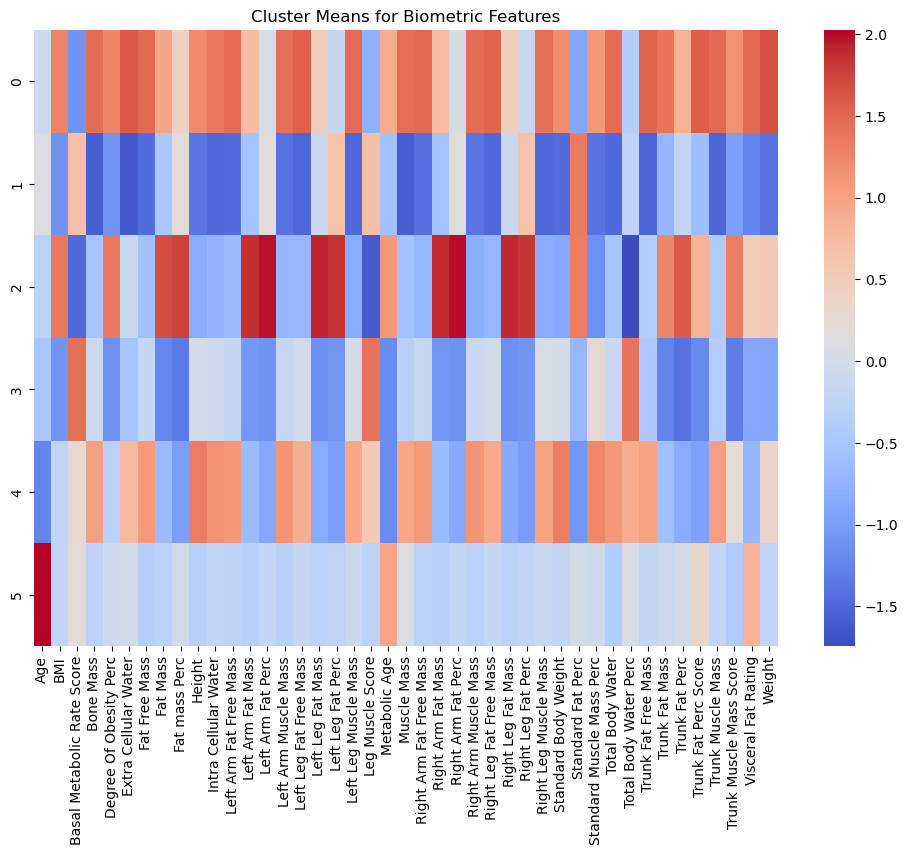

In [52]:
# plot cluster means for each feature without counts dont show counts


plt.figure(figsize=(12, 8))
sns.heatmap(cluster_means_scaled_df.drop(columns=['Count', 'Basal Metabolic Rate']), annot=False, cmap='coolwarm', fmt='.2f')
plt.title('Cluster Means for Biometric Features')
plt.show()


### TSNE DR

In [64]:
from sklearn.manifold import TSNE

bio_features = bio.drop(columns=['CloudId', 'MeasuredOnWeek'])

scaler = StandardScaler()
bio_scaled = scaler.fit_transform(bio_features)

num_clusters = 6  # Adjust the number of clusters as needed
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
bio['Cluster'] = kmeans.fit_predict(bio_scaled)

# Add cluster labels to the DataFrame
bio['Cluster'] = kmeans.labels_

# Optional: Visualize the clusters using PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(bio_scaled)
pca_df_bio = pd.DataFrame(pca_result, columns=['PCA1', 'PCA2'])
pca_df_bio['Cluster'] = bio['Cluster']
pca_df_bio['CloudId'] = bio['CloudId']


fig = px.scatter(
    pca_df_bio, 
    x='PCA1', 
    y='PCA2', 
    color='Cluster', 
    title='PCA of Biometric Profiles',
    hover_data=['CloudId'],
)

fig.update_traces(marker=dict(size=1))

fig.show()

In [42]:
bio_sample = bio.sample(int(0.1*len(bio))).reset_index(drop=True)

In [43]:
from sklearn.manifold import TSNE

bio_features = bio_sample.drop(columns=['CloudId', 'MeasuredOnWeek'])

# Standardize the Data
scaler = StandardScaler()
bio_scaled = scaler.fit_transform(bio_features)

# Apply t-SNE for visualization
tsne = TSNE(n_components=2, perplexity=10, max_iter=2000, random_state=42)
tsne_result = tsne.fit_transform(bio_scaled)
tsne_df_bio = pd.DataFrame(tsne_result, columns=['TSNE1', 'TSNE2'])

tsne_df_bio['CloudId'] = bio_sample['CloudId']



In [46]:
from sklearn.cluster import KMeans
# Apply Clustering
num_clusters = 5 # Adjust the number of clusters as needed
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
bio_sample['Cluster'] = kmeans.fit_predict(bio_scaled)
tsne_df_bio['Cluster'] = bio_sample['Cluster']

<Axes: xlabel='TSNE1', ylabel='TSNE2'>

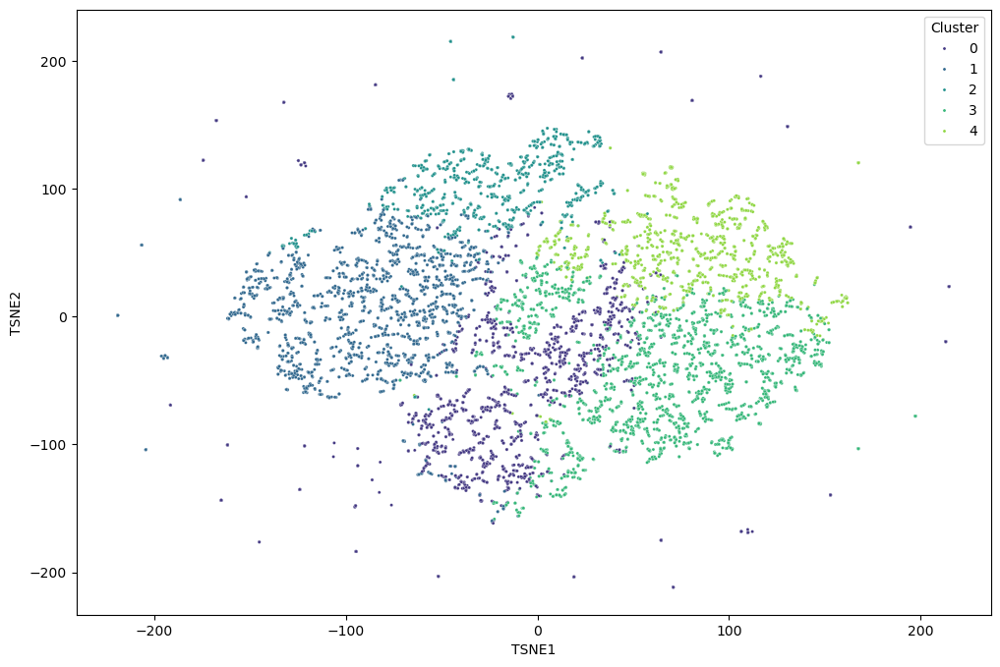

In [47]:
# Plot the data with Seaborn and Matplotlib
plt.figure(figsize=(12, 8))

# Define a color palette
palette = sns.color_palette("viridis", num_clusters)

# Plot the clusters
sns.scatterplot(
    x='TSNE1', 
    y='TSNE2', 
    hue='Cluster', 
    palette=palette, 
    data=tsne_df_bio, 
    legend='full', 
    s=5 # Marker size
)

### UMAP

/opt/anaconda3/envs/umap/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



<Axes: xlabel='UMAP1', ylabel='UMAP2'>

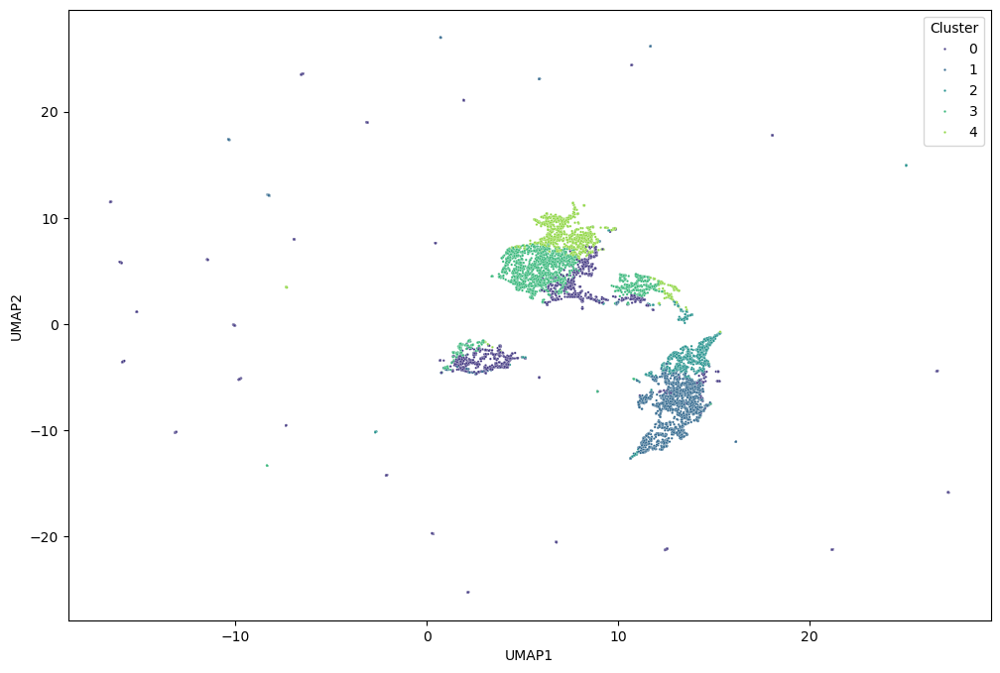

In [49]:
import umap

# Apply UMAP for visualization
umap_reducer = umap.UMAP(n_components=2, random_state=42)
umap_result = umap_reducer.fit_transform(bio_scaled)
umap_df_bio = pd.DataFrame(umap_result, columns=['UMAP1', 'UMAP2'])
umap_df_bio['Cluster'] = bio_sample['Cluster']
umap_df_bio['CloudId'] = bio_sample['CloudId']



In [ ]:
# Plot the data with Seaborn and Matplotlib
plt.figure(figsize=(12, 8))

# Define a color palette
palette = sns.color_palette("viridis", num_clusters)

# Plot the clusters
sns.scatterplot(
    x='UMAP1', 
    y='UMAP2', 
    hue='Cluster', 
    palette=palette, 
    data=umap_df_bio, 
    legend='full', 
    s=3  # Marker size
)

In [195]:
# merge bio and pca_df on cloudid and keep only the columns with PCA1 and PCA2
bio_pca = pd.merge(bio, pca_df, on=['CloudId', 'MeasuredOnWeek'])

In [174]:
pca_df_bio

,PCA1,PCA2,Cluster,CloudId
0,3.982330,0.499035,4,0015d65e3205deb6bb6a8f0d57cc48547918f0f2
1,3.982330,0.499035,4,0015d65e3205deb6bb6a8f0d57cc48547918f0f2
2,3.982330,0.499035,4,0015d65e3205deb6bb6a8f0d57cc48547918f0f2
3,4.155510,0.826356,4,0015d65e3205deb6bb6a8f0d57cc48547918f0f2
4,4.128284,-0.168627,4,0015d65e3205deb6bb6a8f0d57cc48547918f0f2
...,...,...,...,...
90420,-0.239426,-0.394461,0,fff39b07939109e856b411ff8dd9b22da1f1ff2e
90421,-0.446838,-0.547131,0,fff39b07939109e856b411ff8dd9b22da1f1ff2e
90422,0.088667,-0.515449,0,fff39b07939109e856b411ff8dd9b22da1f1ff2e
90423,0.011897,-0.764820,0,fff39b07939109e856b411ff8dd9b22da1f1ff2e


In [189]:
# Select a subset of unique CloudId values (e.g., the first 30 unique CloudIds)
unique_cloud_ids = pca_df_bio['CloudId'].unique()[:30]

# Initialize a new figure
fig = go.Figure()

# Iterate over each selected CloudId and add a trace for each
for cloud_id in unique_cloud_ids:
    user_data = pca_df_bio[pca_df_bio['CloudId'] == cloud_id]
    fig.add_trace(go.Scatter(
        x=user_data['PCA1'],
        y=user_data['PCA2'],
        mode='lines+markers',
        line_shape='spline',
        text=user_data.apply(lambda row: '<br>'.join([f'{col}: {row[col]}' for col in ['Cluster']]), axis=1),
        # text=user_data.apply(lambda row: '<br>'.join([f'{col}: {row[col]}' for col in ['Weight', 'Basal Metabolic Rate', 'Basal Metabolic Rate Score', 'Degree Of Obesity Perc', 'Cluster']]), axis=1),
        # hoverinfo='text',
        marker_color=user_data['Cluster'],  # Adjusted marker size and color by cluster
        line=dict(shape='spline'),
    ))

fig.update_layout(
    title='2D PCA Plot of User Data by Week with Temporal Evolution',
    xaxis_title='PCA1',
    yaxis_title='PCA2',
    showlegend=True
)

# Add a legend to the plot
fig.update_layout(
    legend_title_text='Cluster',
    legend_title_font_size=16,
    legend_font_size=12
)

fig.show()

In [196]:
# Group by CloudId and count the number of unique clusters for each user
user_cluster_counts = bio.groupby('CloudId')['Cluster'].nunique()

# Filter users who have more than one distinct cluster
users_with_multiple_clusters = user_cluster_counts[user_cluster_counts > 1]

# Get the number of such users
num_users_with_multiple_clusters = users_with_multiple_clusters.shape[0]

total_users = bio['CloudId'].nunique()
percentage_users_with_multiple_clusters = (num_users_with_multiple_clusters / total_users) * 100

percentage_users_with_multiple_clusters

27.765419615773506